In [1]:
#%reload_ext autoreload
%load_ext autoreload
%autoreload 2
%matplotlib inline

import os
import glob
import time
import re
import sys
import pprint

import numpy as np
import pandas as pd
import pandas.tools.plotting as pdplot

import scipy.signal
import scipy.misc
import scipy.ndimage.filters

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec

import statsmodels.api as sm

import sklearn.decomposition
import sklearn.metrics

import skimage.filters
import skimage.util

import cv2
import SimpleITK as sitk
selx = sitk.SimpleElastix()

from pyqt_fit import plot_fit 

from ipywidgets import interact, interactive, fixed
#from IPython.html import widgets
import ipywidgets as widgets
from IPython.display import clear_output, display, HTML
from detect_peaks import detect_peaks

import registration_utilities as ru
import registration_callbacks as rc

import utils

#Some nice default configuration for plots
plt.rcParams['figure.figsize'] = 30, 7.5
plt.rcParams['axes.grid'] = True
plt.gray()

linewidth = 4
markersize = 12
legendsize = 32  # 'medium'
labelsize = 28
ticksize = 20  # 'medium'
titlesize = 32  # large

plt.rcParams['xtick.labelsize'] = ticksize
plt.rcParams['ytick.labelsize'] = ticksize
plt.rcParams['lines.linewidth'] = linewidth
plt.rcParams['lines.markersize'] = markersize
plt.rcParams['axes.labelsize'] = labelsize
plt.rcParams['legend.fontsize'] = legendsize
plt.rcParams['axes.titlesize'] = titlesize
plt.rcParams['text.usetex'] = False

Warning, cannot import Cython kernel functions, pure python functions will be used instead


## Set results root directory

In [2]:
#resultsRootDir = '.'
#resultsRootDir = 'results'
#resultsRootDir = 'resultsPaper'
resultsRootDir = 'paper_figures'

## Load Image Data From Disk

##### Set the data root directory here

In [3]:
#dataRootDir = 'data/SHeart-HRes-LFPS/'
#dataRootDir = 'data/SHeart2015-01-21/'
#dataRootDir = 'data/SHeart2015-02-20-HRes-HFPS/'
# dataRootDir = 'data/fromMonte/Validation_Study_Export27July2015/'
dataRootDir = 'data/fromMonte/Validation_Study_Export27July2015/decoded/'

# List all readable data files
dataFiles = {'prefix': [],
             'ext': [],
             'path': []}

i = 0
for f in os.listdir(dataRootDir):
    
    prefix, ext = os.path.splitext(f)
    
    if ext not in ['.mha', '.avi', '.tif', '.mp4']:        
        continue        
    else:
        print '%d: %s' % (i, f)        
        dataFiles['prefix'].append(prefix)
        dataFiles['ext'].append(ext)
        dataFiles['path'].append( os.path.join(dataRootDir, f) )
        i += 1    

0: 2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode.mha
1: 2015-07-27-10-36-06_2015-07-15-16-56-27_1.raw.bmode.mha
2: 2015-07-27-10-36-06_2015-07-15-16-56-36_1.raw.bmode.mha
3: 2015-07-27-10-36-06_2015-07-15-16-56-46_1.raw.bmode.mha
4: 2015-07-27-10-36-06_2015-07-15-16-57-35_1.raw.bmode.mha
5: 2015-07-27-10-36-06_2015-07-15-16-57-51_1.raw.bmode.mha


##### Select dataset to analyze

In [4]:
xyROI = {}
downsizeAmount = None
mmode_pos = None
outFPS = 30

# set parameters
if True: # decoded vevo2100 data from Monte
    
    datasetId = 0
    downsizeAmount = 0.5
    
    mmode_preset = [850, 850, 850, 750, 750, 750]
    mmode_pos_org = downsizeAmount * mmode_preset[datasetId]
    resizeAmount = 1.0

if False: # vevo2100 data AVIs from Monte
    
    datasetId = 6    
    downsizeAmount = None

    # xyROI = { 'min_X': 270, 'max_X': 520, 'min_Y': 82, 'max_Y': 266 }
    # mmode_pos = 190
    # resizeAmount = 2.0 # for opencv video display only    
    
    xyROI = { 'min_X': 115, 'max_X': 725, 'min_Y': 120, 'max_Y': 540 }
    # xyROI = { 'min_X': 400, 'max_X': 725, 'min_Y': 250, 'max_Y': 540 }  # chamber ROI
    mmode_pos_org = 590 # 590
    resizeAmount = 1.0 # for opencv video display only    

if False: # high-res probe High FPS
    
    datasetId = 2     
    downsizeAmount = 0.5
    xyROI = {'min_X': np.round(250 * downsizeAmount),
             'max_X': np.round(1300 * downsizeAmount), 
             'min_Y': np.round(40 * downsizeAmount) }
    #xyROI = { 'min_X': 600, 'max_X': 1000, 'min_Y': 300, 'max_Y': 750 }
    resizeAmount = 1.0 / downsizeAmount # for opencv video display only    

if False: # high-res probe Low FPS
    
    datasetId = 2 
    xyROI = { 'min_X': 150, 'max_X': 850 }
    resizeAmount = 0.75 # for opencv video display

if False: # Low-res probe
    
    datasetId = 7 
    framesPerSec = 10
    resizeAmount = 1.0 # for opencv video display only
    
print 'Selected dataset: ',  dataFiles['path'][datasetId]    

Selected dataset:  data/fromMonte/Validation_Study_Export27July2015/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode.mha


##### Load selected dataset

In [5]:
# load data
print "\nLoading %s: \n" % (dataFiles['path'][datasetId])

if dataFiles['ext'][datasetId] == '.mha':
    
    imInput_sitk = sitk.ReadImage( dataFiles['path'][datasetId] )
    
    imInput_highres_uncropped = np.transpose(sitk.GetArrayFromImage(imInput_sitk), [1, 2, 0])

    inputSpacing = np.array(imInput_sitk.GetSpacing())[[1, 0, 2]]
    
    if downsizeAmount is not None and downsizeAmount < 1.0:
        
        imInput_highres_uncropped = scipy.ndimage.zoom(imInput_highres_uncropped, 
                                                       (downsizeAmount, downsizeAmount, 1))
         
        inputSpacing[:2] /= downsizeAmount
        
    print '\tSpacing: ', inputSpacing
    
    framesPerSec = 1000.0 / inputSpacing[2]
    # framesPerSec = 30
    
elif dataFiles['ext'][datasetId] in [ '.avi', '.tif', '.mp4' ]:    

    cap = cv2.VideoCapture(dataFiles['path'][datasetId])
    print cap.isOpened()
    cap.release()
    
    imInput_highres_uncropped, metadata = utils.loadVideoFromFile(dataFiles['path'][datasetId], 
                                                                  resizeAmount=downsizeAmount)
    
    if dataFiles['ext'][datasetId] == '.avi':
    
        if metadata.has_key('FPS'):
            framesPerSec = metadata['FPS']
            
        if metadata.has_key('FRAME_COUNT'):                           
            
            if metadata['FRAME_COUNT'] < imInput_highres_uncropped.shape[2]:
                
                numChannels = imInput_highres_uncropped.shape[2] / metadata['FRAME_COUNT']                
                print 'Video seems to be in color with %d channels' % numChannels
                imInput_highres_uncropped = imInput_highres_uncropped[:,:,::numChannels]
        pass
else:    
    raise ValueError('Unknown file type %s' % dataFiles['ext'][datasetId])

print '\tImage Size: ', imInput_highres_uncropped.shape
print '\tFrame rate: %f FPS' % framesPerSec


Loading data/fromMonte/Validation_Study_Export27July2015/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode.mha: 



/home/cdeepakroy/anaconda/envs/lcus/lib/python2.7/site-packages/scipy/ndimage/interpolation.py:568: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


	Spacing:  [ 0.0239362   0.0239444   4.28992987]
	Image Size:  (376, 505, 300)
	Frame rate: 233.104044 FPS


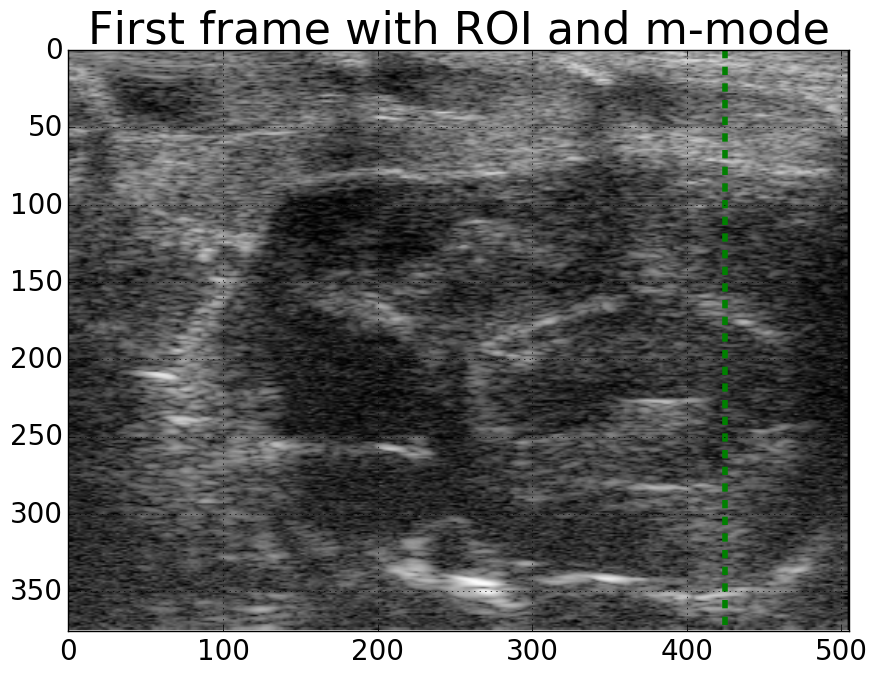

In [7]:
# show first frame
plt.figure()

plt.imshow(imInput_highres_uncropped[:, :, 0])

if all(k in xyROI for k in ['min_X', 'max_X', 'min_Y', 'max_Y']):

    plt.gca().add_patch( 
        mpatches.Rectangle((xyROI['min_X'], xyROI['min_Y']),
                          xyROI['max_X'] - xyROI['min_X'] + 1, 
                          xyROI['max_Y'] - xyROI['min_Y'] + 1, 
                           fill=False, color='r', linestyle='--') 
    )

    if mmode_pos_org is not None:

        plt.plot([mmode_pos_org, mmode_pos_org], 
                 [xyROI['min_Y'], xyROI['max_Y']], 'g--', linewidth=4.0)
        
else:
    
    if mmode_pos_org is not None:

        plt.plot([mmode_pos_org, mmode_pos_org], 
                 [0, imInput_highres_uncropped.shape[0]], 'g--', linewidth=4.0)
    
plt.xlim([0, imInput_highres_uncropped.shape[1]])
plt.ylim([imInput_highres_uncropped.shape[0], 0])
_ = plt.title('First frame with ROI and m-mode')


Image Size After Cropping:  (376, 505, 300)


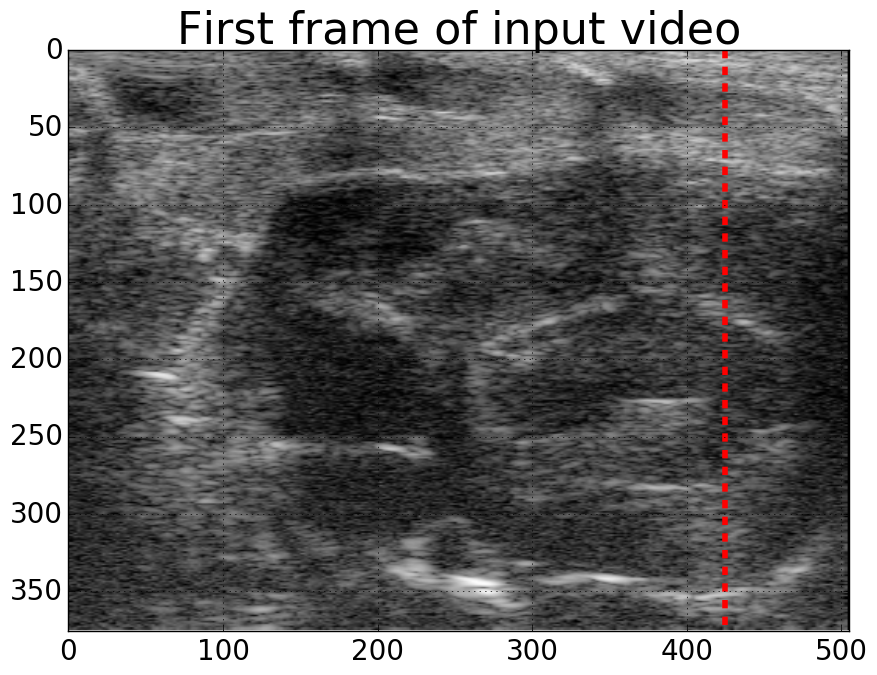

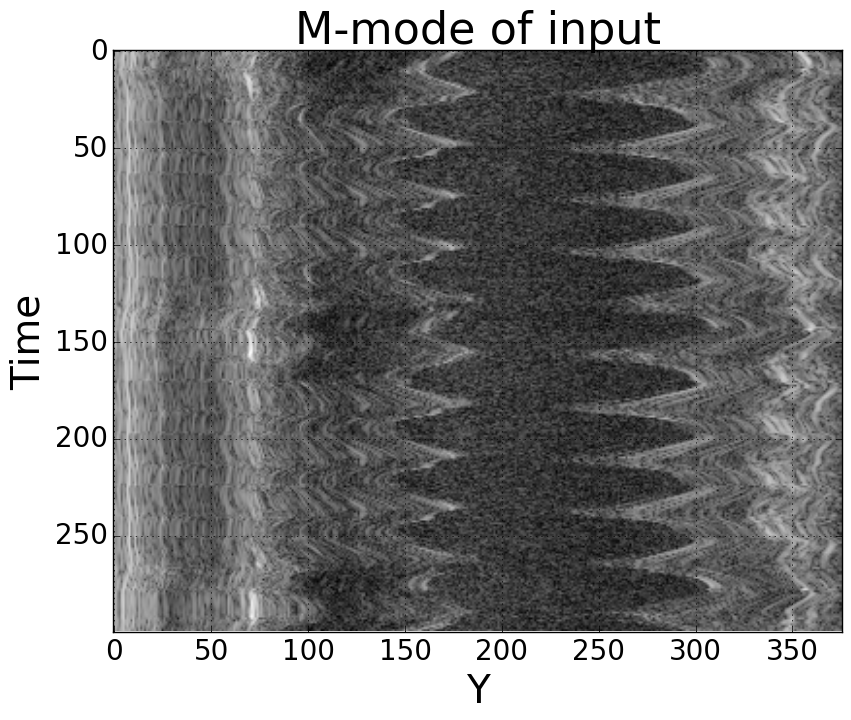

In [8]:
# crop if requested
xBounds = [0, imInput_highres_uncropped.shape[1]]

if xyROI.has_key('min_X'):
    xBounds[0] = xyROI['min_X']    
if xyROI.has_key('max_X'):    
    xBounds[1] = xyROI['max_X']

yBounds = [0, imInput_highres_uncropped.shape[0]]

if xyROI.has_key('min_Y'):
    yBounds[0] = xyROI['min_Y']    
if xyROI.has_key('max_Y'):    
    yBounds[1] = xyROI['max_Y']
    
imInput_highres = imInput_highres_uncropped[yBounds[0]:yBounds[1], xBounds[0]:xBounds[1], :] 
imInput_highres_prenoise = imInput_highres

print '\nImage Size After Cropping: ', imInput_highres.shape

if mmode_pos_org is None:    
    mmode_pos = imInput_highres.shape[1] / 2
elif xyROI.has_key('min_X'):
    mmode_pos = mmode_pos_org - xyROI['min_X']
else:
    mmode_pos = mmode_pos_org
mmode_pos = np.int(mmode_pos)
    
# show first frame
plt.figure()

plt.imshow(imInput_highres[:, :, 0])
plt.plot([mmode_pos, mmode_pos], [0, imInput_highres.shape[0]], 
         'r--', linewidth=4.0)

plt.xlim([0, imInput_highres.shape[1]])
plt.ylim([imInput_highres.shape[0], 0])
_ = plt.title('First frame of input video')

# show mid XT slice of downsampled input before and after noise
plt.figure()

plt.imshow(imInput_highres[:, mmode_pos, :].T)
plt.xlabel('Y')
plt.ylabel('Time')
plt.title('M-mode of input')

In [9]:
# make results dir
resultFilePrefix = dataFiles['prefix'][datasetId]

resultsDir = os.path.join(resultsRootDir, 
                          os.path.split( os.path.abspath(dataRootDir) )[1], 
                          dataFiles['prefix'][datasetId])
if not os.path.exists(resultsDir):
    os.makedirs(resultsDir)
    
print 'Results store directory: ', resultsDir    

Results store directory:  paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode


In [11]:
# write original input video
utils.writeVideoToFile(
    utils.normalizeArray( utils.AddTextOnVideo(imInput_highres, 'Input - %.2f fps' % framesPerSec) ) * 255, 
    os.path.join(resultsDir, 'Input_highres.avi'), 
    codec='DIVX', fps=outFPS
)

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/Input_highres.avi took 1.17253994942 seconds


In [10]:
# show video
utils.cvShowVideo(utils.normalizeArray(imInput_highres), 'Input Video', resizeAmount=resizeAmount)

# Artificially downsample the data along the time dimension

In [12]:
#set parameters
timeDownsamplingFrameStep = 1

assert(timeDownsamplingFrameStep >= 1 and (timeDownsamplingFrameStep - np.floor(timeDownsamplingFrameStep) == 0))
       
# downsample the data by the specified amount
imInput = imInput_highres[:, :, ::timeDownsamplingFrameStep]

input_bounds = [imInput.min(), imInput.max()]

framesPerSecDownsmp = framesPerSec * (1.0 / timeDownsamplingFrameStep)

print '\nImage Size before downsampling in time: ', imInput_highres.shape
print 'Image Size after downsampling in time: ', imInput.shape

print '\nFrames per sec before downsampling in time: ', framesPerSec
print 'Frames per sec after downsampling in time: ', framesPerSecDownsmp


Image Size before downsampling in time:  (376, 505, 300)
Image Size after downsampling in time:  (376, 505, 300)

Frames per sec before downsampling in time:  233.104043901
Frames per sec after downsampling in time:  233.104043901


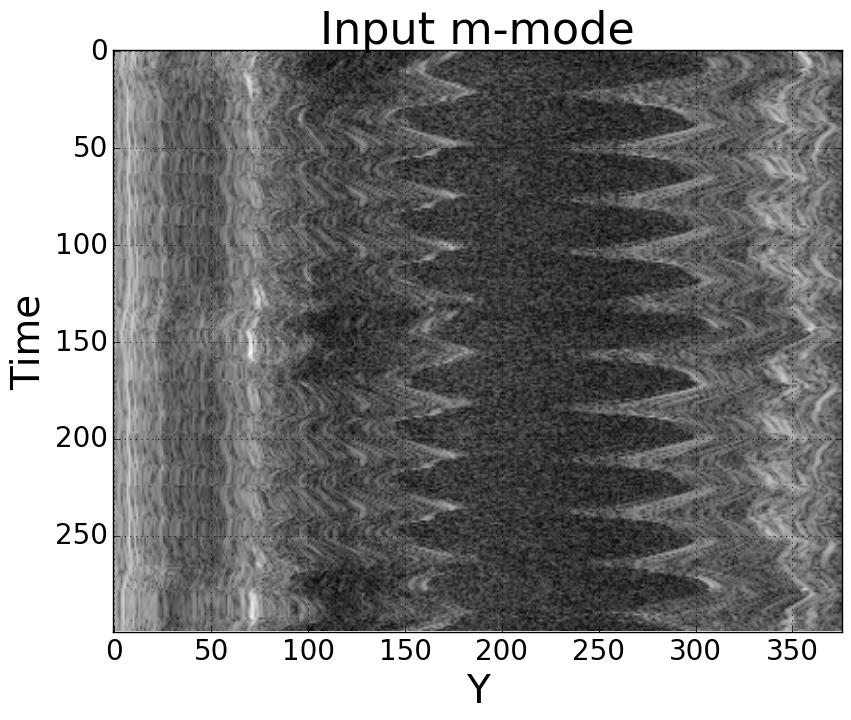

In [13]:
# show mid XT slice of downsampled input before and after noise
plt.figure()

plt.imshow(imInput[:, mmode_pos, :].T)
plt.xlabel('Y')
plt.ylabel('Time')
plt.title('Input m-mode')

In [14]:
# write our result
utils.writeVideoToFile(
    utils.normalizeArray( utils.AddTextOnVideo(imInput, 'Input') ) * 255, 
    os.path.join(resultsDir, 'Input.avi'), 
    codec='DIVX', fps=outFPS)

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/Input.avi took 0.980859994888 seconds


In [15]:
utils.cvShowVideo(
    [utils.normalizeArray(imInput_highres, input_bounds), utils.normalizeArray(imInput)],
    ['Input high-res video', 'Input artifical low-res video'], resizeAmount=resizeAmount
)

### Run the algorithm

In [17]:
import uspgs

In [20]:
# Parameters
algo_params = {
    
    'median_filter_size': 1,
    'apply_lr_denoising': False,    
    'lr_gamma_factor': 2,
    'lr_xy_downsampling': 0.5,
    'lr_conv_tol': 1e-4,
    
    'similarity_method': 'ncorr',  # 'ncorr' or 'pca'
    'detrend_method': 'hp',  # 'lowess' or 'hp'
    'lowess_mode': '-',
    'hp_lamda': 6400,
    
    'respiration_present': True,
    'resp_phase_cutoff': 0.2
}

print algo_params

algo = uspgs.USPGS(**algo_params)
algo.set_input(imInput)
algo.process() 

{'lr_gamma_factor': 2, 'similarity_method': 'ncorr', 'detrend_method': 'hp', 'lowess_mode': '-', 'hp_lamda': 6400, 'median_filter_size': 1, 'lr_conv_tol': 0.0001, 'respiration_present': True, 'apply_lr_denoising': False, 'lr_xy_downsampling': 0.5, 'resp_phase_cutoff': 0.2}
Input video size:  (376, 505, 300)

>> Step-1: Suppressing noise ...


Noise suppression took 5.09 seconds

>> Step-2: Estimating instantaneous phase ...


Computing similarity using normalized correlation ...  took 0.814040899277 seconds
Chose frame 48 as key frame
Estimated period = 27.27 frames
Estimated number of periods = 11.00
Frames with bad respiration influence = 29.33%

Phase estimation took 1.34 seconds

>> Done processing ... took a total of 6.43 seconds


In [22]:
# retrieve noise suppression results
imInputDenoised = algo.imInputDenoised_

if algo_params['apply_lr_denoising']:
    
    imD = algo.imD_
    imLowRank = algo.imLowRank_
    imSparse = algo.imSparse_

# retrieve phase estimation results
if algo_params['similarity_method'] == 'pca':
    X_proj = algo.X_proj_
    
simMat = algo.simMat_
simMat_Trend = algo.simMat_Trend_
simMat_Seasonal = algo.simMat_Seasonal_
spectralEntropy = algo.spectralEntropy_
fid_best = algo.fid_best_

ts = algo.ts_
ts_trend = algo.ts_trend_
ts_seasonal = algo.ts_seasonal_
period = algo.period_

ts_analytic = algo.ts_analytic_
ts_instaamp = algo.ts_instaamp_
ts_instaphase = algo.ts_instaphase_
ts_instaphase_nmzd = algo.ts_instaphase_nmzd_

ts_trend_analytic = algo.ts_trend_analytic_
ts_trend_instaamp = algo.ts_trenda_instaamp_
ts_trend_instaphase = algo.ts_trend_instaphase_
ts_trend_instaphase_nmzd = algo.ts_trend_instaphase_nmzd_

image_aspect = np.float(imInput.shape[1]) / imInput.shape[0]

In [23]:
if algo_params['apply_lr_denoising']:

    utils.cvShowVideo(
        [utils.normalizeArray(imInput), 
         utils.normalizeArray(imLowRank, input_bounds), utils.normalizeArray(imSparse, input_bounds)],
        ['Input video', 'Lowrank video', 'Sparse video'], resizeAmount=resizeAmount
    )
    
else:
    
    utils.cvShowVideo(
        [utils.normalizeArray(imInput), utils.normalizeArray(imInputDenoised, input_bounds)],
        ['Input video', 'Denoised video'], resizeAmount=resizeAmount
    )

#### Read physiological measurments file

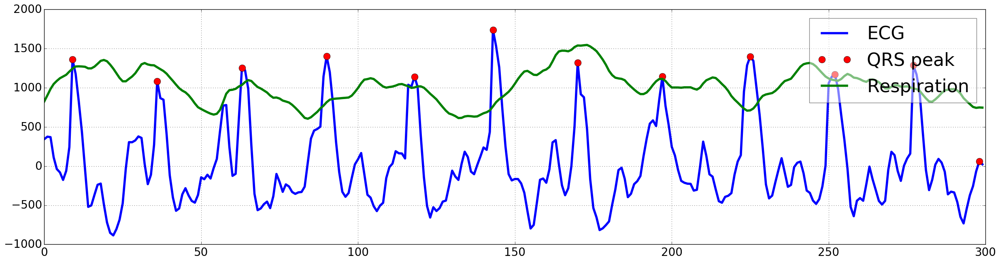

In [24]:
fname = os.path.basename(dataFiles['path'][datasetId])
fname_wout_ext = os.path.splitext(fname)[0]
bmode_physio_file = os.path.join(dataRootDir, fname_wout_ext + '.csv')
df = pd.read_csv(bmode_physio_file, skipinitialspace=True)

qrs_ploc = detect_peaks(df.ECG, mpd=algo.period_ * 0.75, valley=False, show=False)

fig, ax = plt.subplots(1)

ax.plot(df.ECG, label='ECG')
ax.plot(qrs_ploc, df.ECG[qrs_ploc], 'ro', label='QRS peak')
ax.plot(df.Respiration, label='Respiration')
ax.legend(framealpha=0.5)

#### Show five evenly spaced frames between two qrs peaks

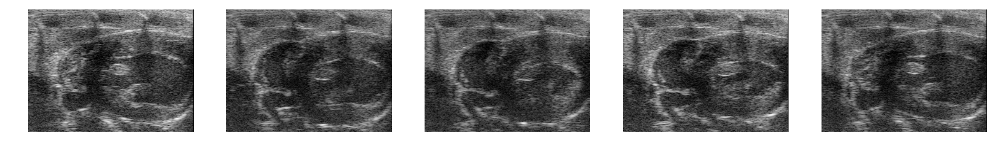

In [25]:
f = range(qrs_ploc[1], qrs_ploc[2], (qrs_ploc[2] - qrs_ploc[1]) / 4)

fig, ax = plt.subplots(1, len(f))

for i in range(len(f)):
    
    ax[i].imshow(imInput[:, :, f[i]])
    ax[i].axis('off')

#### Investigate phase estimation

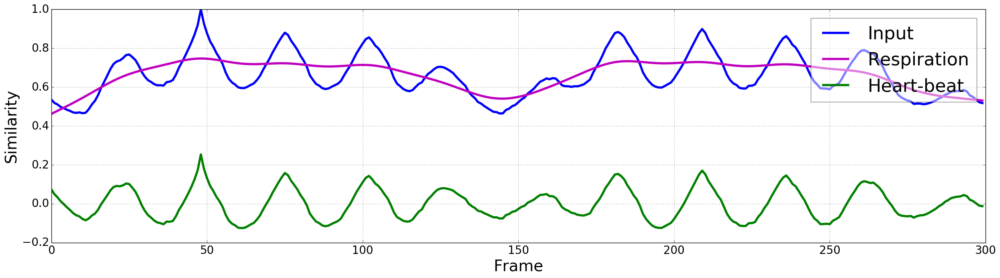

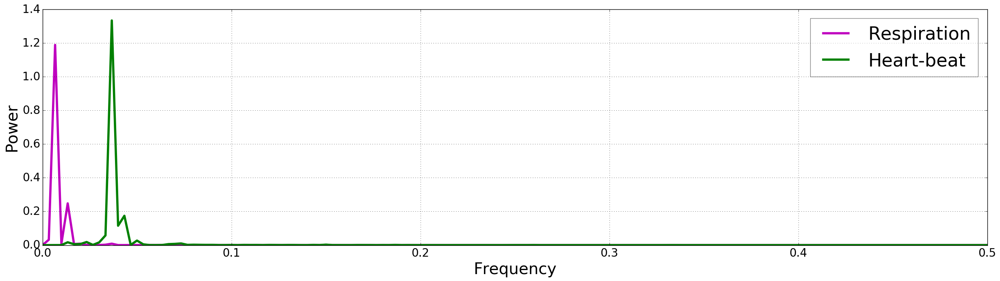

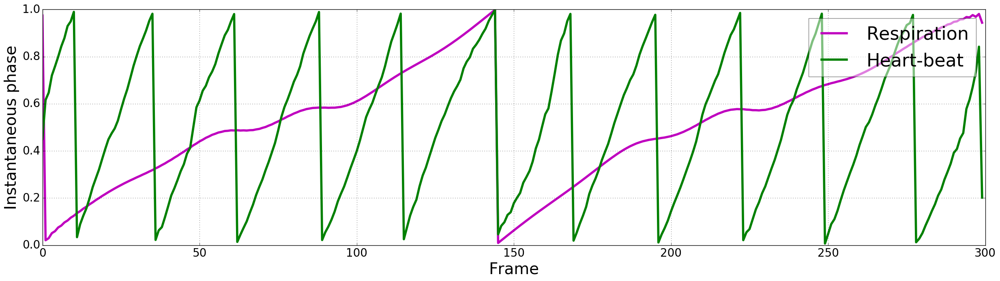

In [26]:
plt.figure()

plt.plot(ts, 'b-', label='Input')
plt.plot(ts_trend, 'm-', label='Respiration')
plt.plot(ts_seasonal, 'g-', label='Heart-beat')
plt.xlabel('Frame')
plt.ylabel('Similarity')
plt.legend(framealpha=0.5)

# show frequency spectrum of trend and seasonal components
freq_trend, power_trend = scipy.signal.periodogram(ts_trend)
freq_seasonal, power_seasonal = scipy.signal.periodogram(ts_seasonal)

plt.figure()
plt.plot(freq_trend, power_trend, 'm-', label='Respiration')
plt.plot(freq_seasonal, power_seasonal, 'g-', label='Heart-beat')
plt.xlabel('Frequency')
plt.ylabel('Power')
plt.legend(framealpha=0.5)

# show estimate instantaneous phase of heart-beat and respiration
plt.figure()
plt.plot(ts_trend_instaphase_nmzd, 'm-', label='Respiration')
plt.plot(ts_instaphase_nmzd, 'g-', label='Heart-beat')
plt.xlabel('Frame')
plt.ylabel('Instantaneous phase')
plt.legend(framealpha=0.5)

#### Compare instantaneous phase agains ECG

QRS peak         :  [  9  36  63  90 118 143 170 197 225 252 277]
instaphase valley:  [ 11  36  62  89 115 145 169 196 223 249 278]
similarity valley:  [ 11  36  61  88 114 144 171 196 222 247 277]

R^2 instaphase valley vs ECG =  0.999559418937

Difference between instaphase valley and qrs peak locations: 
	[2 0 1 1 3 2 1 1 2 3 1]
	Median = 1, IQR = 1.00


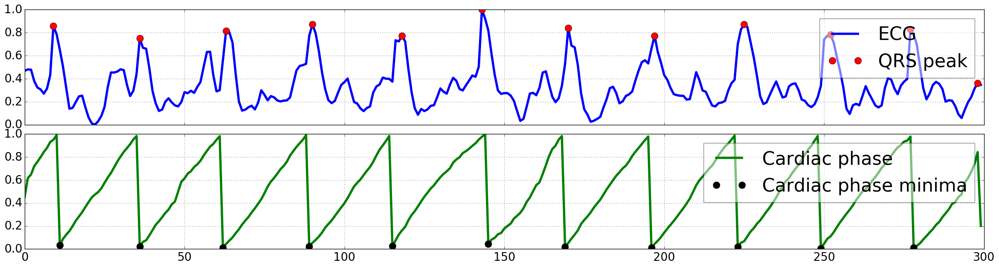

In [27]:
ecg_norm = utils.normalizeArray(df.ECG)
qrs_ploc = detect_peaks(ecg_norm, mpd=algo.period_ * 0.75, valley=False, show=False)

ts_seasonal_norm = utils.normalizeArray(ts_seasonal)
ts_seasonal_vloc = detect_peaks(ts_seasonal_norm, mpd=algo.period_ * 0.75, valley=True, show=False)

ts_instaphase_nmzd_vloc = detect_peaks(ts_instaphase_nmzd, mpd=algo.period_ * 0.65, valley=True, show=False)

num_points = min([qrs_ploc.size, ts_instaphase_nmzd_vloc.size])

print 'QRS peak         : ', qrs_ploc[:num_points]
print 'instaphase valley: ', ts_instaphase_nmzd_vloc[:num_points]
print 'similarity valley: ', ts_seasonal_vloc[:num_points]

print '\nR^2 instaphase valley vs ECG = ', sklearn.metrics.r2_score(qrs_ploc[:num_points], 
                                                                    ts_instaphase_nmzd_vloc[:num_points])

insta_qrs_diff = np.abs(ts_instaphase_nmzd_vloc[:num_points] - qrs_ploc[:num_points])

print '\nDifference between instaphase valley and qrs peak locations: \n\t', insta_qrs_diff
print '\tMedian = %d, IQR = %.2f' % (np.median(insta_qrs_diff), 
                                                          scipy.stats.iqr(insta_qrs_diff))

fig, ax = plt.subplots(2, 1, sharex=True)
fig.subplots_adjust(hspace=0.08)

ax[0].plot(ecg_norm, 'b', label='ECG')
ax[0].plot(qrs_ploc, ecg_norm[qrs_ploc], 'ro', label='QRS peak')
ax[0].legend(framealpha = 0.5)

ax[1].plot(ts_instaphase_nmzd, 'g-', label='Cardiac phase')
ax[1].plot(ts_instaphase_nmzd_vloc, ts_instaphase_nmzd[ts_instaphase_nmzd_vloc], 'ko', label='Cardiac phase minima')
ax[1].legend(framealpha = 0.5)

# plt.plot(ts_seasonal_norm, 'g-', label='heart')
# plt.plot(ts_seasonal_vloc, ts_seasonal_norm[ts_seasonal_vloc], 'mo')

_ = plt.setp([a.get_xticklabels() for a in ax[:-1]], visible=False)

#### Visually check evenly spaced between two consecutive QRS peaks or instaphase valleys

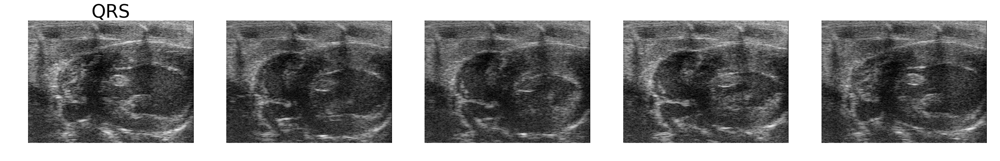

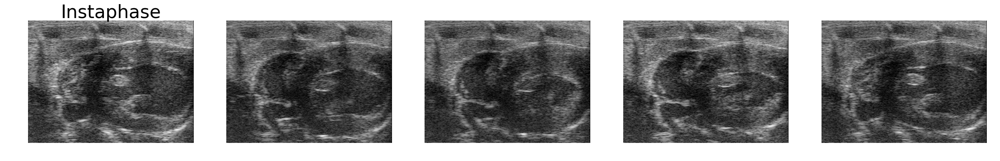

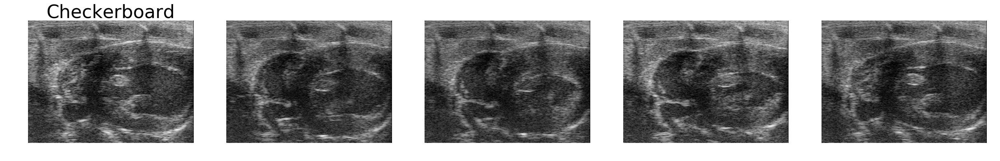

In [28]:
pid = 1
n_frames = 5

# QRS
plt.figure()

f_qrs = range(qrs_ploc[pid], qrs_ploc[pid+1], (qrs_ploc[pid+1] - qrs_ploc[pid]) / (n_frames - 1))

for i in range(len(f_qrs)):
    
    plt.subplot(1, len(f_qrs), i+1)
    plt.imshow(imInput[:, :, f_qrs[i]])
    plt.axis('off')
    
    if i == 0:
        plt.title('QRS')

# Instaphase    
plt.figure()

f_insta = range(ts_instaphase_nmzd_vloc[pid], ts_instaphase_nmzd_vloc[pid+1], 
          (ts_instaphase_nmzd_vloc[pid+1] - ts_instaphase_nmzd_vloc[pid]) / (n_frames - 1))

for i in range(len(f_insta)):
    
    plt.subplot(1, len(f_insta), i+1)
    plt.imshow(imInput[:, :, f_insta[i]])
    plt.axis('off')    

    if i == 0:
        plt.title('Instaphase')
        
        
# checkerboard    
plt.figure()

for i in range(len(f_qrs)):    
    
    im_chk = utils.vis_checkerboard(imInput[:, :, f_qrs[i]], imInput[:, :, f_insta[i]])
    
    plt.subplot(1, len(f_qrs), i+1)
    plt.imshow(im_chk)
    plt.axis('off')    

    if i == 0:
        plt.title('Checkerboard')        

#### Visually compare images at corresponding QRS peaks, instaphase valley, similarity valley

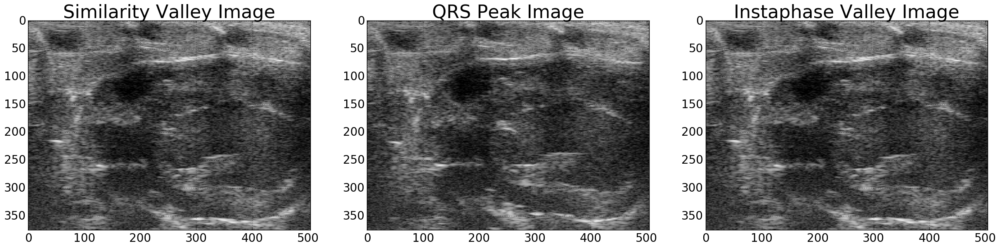

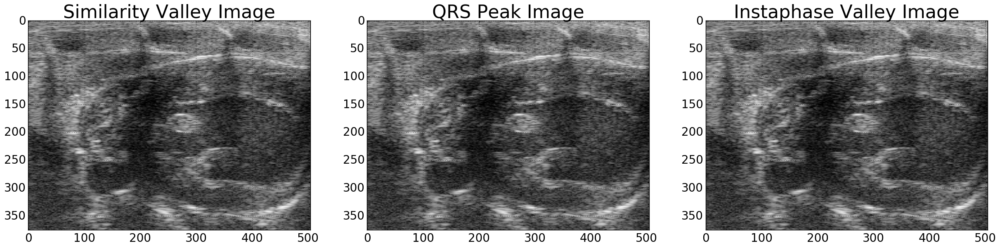

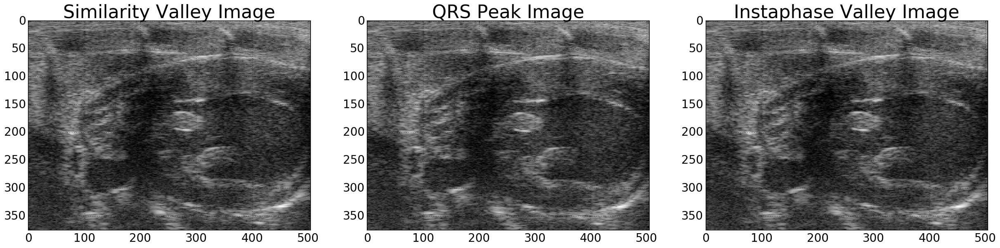

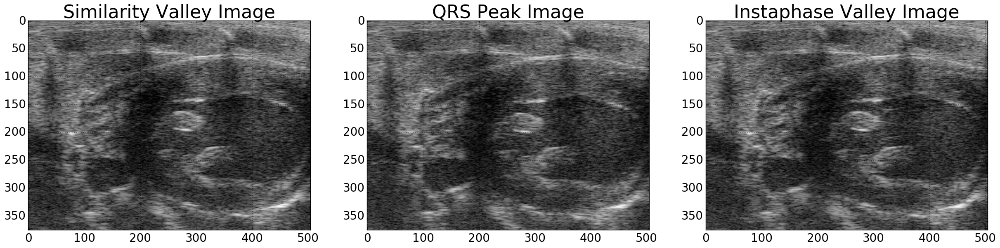

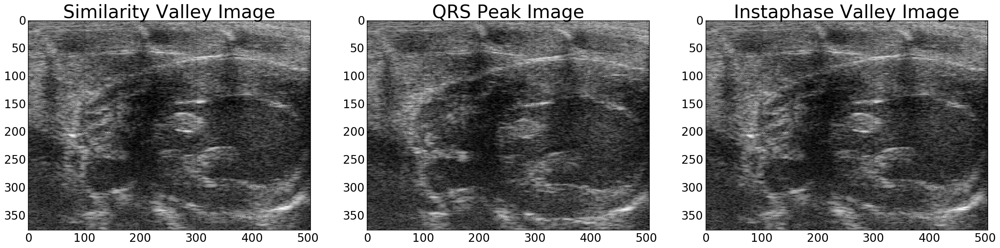

...

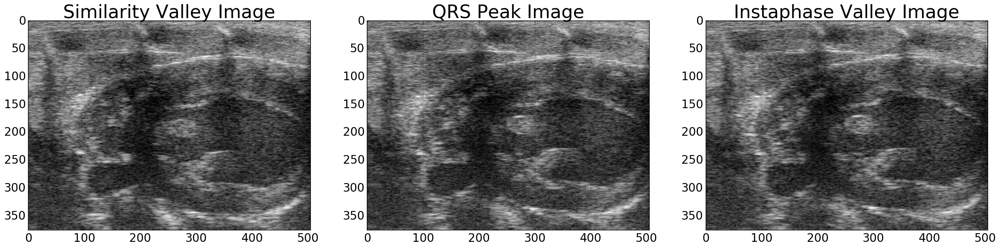

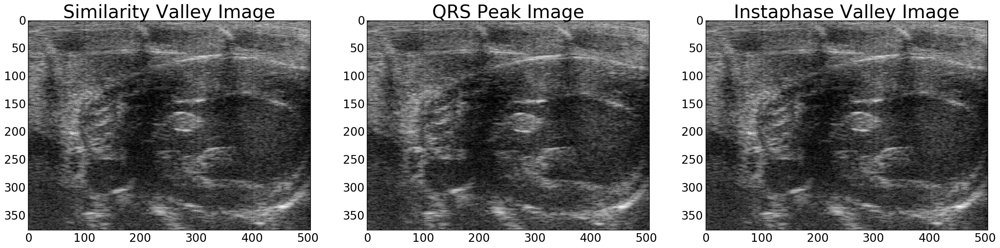

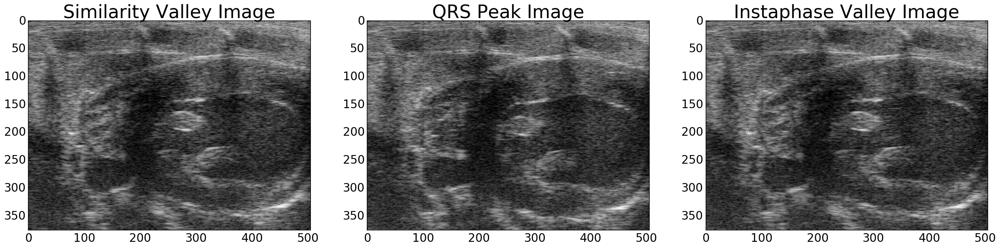

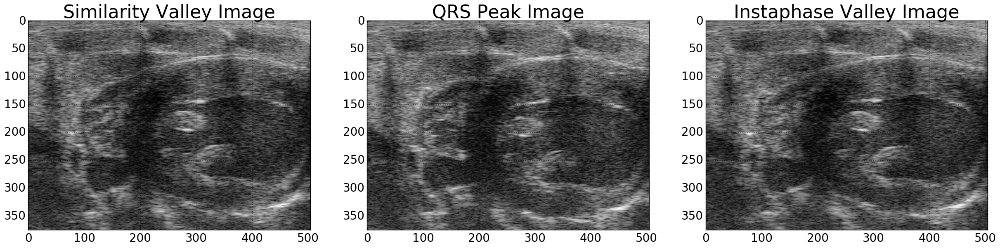

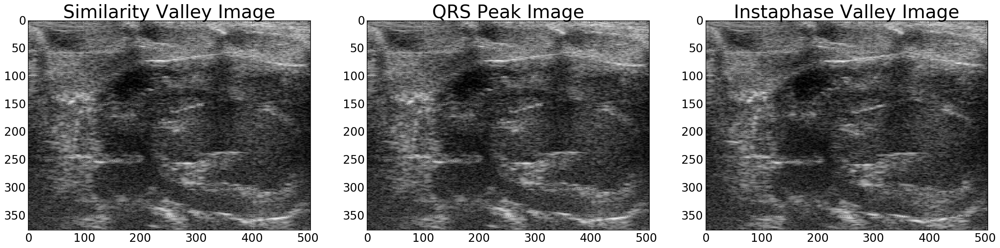

In [29]:
for i in range(np.min([qrs_ploc.size, ts_seasonal_vloc.size, ts_instaphase_nmzd_vloc.size])):
    
    plt.figure()

    plt.subplot(1, 3 ,1)
    plt.imshow(imInput[:, :, ts_seasonal_vloc[i]])
    plt.title('Similarity Valley Image')

    plt.subplot(1, 3 ,2)
    plt.imshow(imInput[:, :, qrs_ploc[i]])
    plt.title('QRS Peak Image')

    plt.subplot(1, 3, 3)
    plt.imshow(imInput[:, :, ts_instaphase_nmzd_vloc[i]])
    plt.title('Instaphase Valley Image')    

#### Investigate respiratory gating

29.33% frames gated due to respiration influence


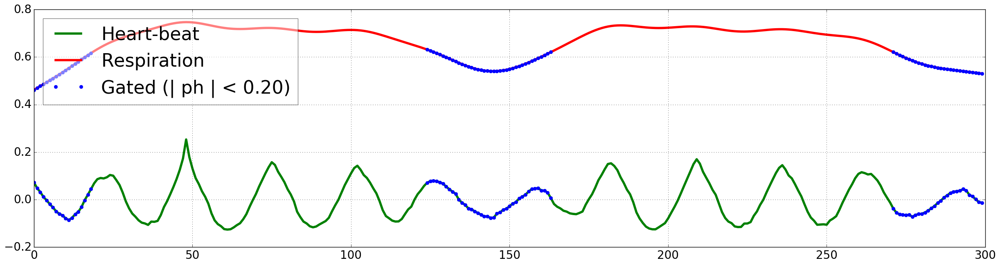

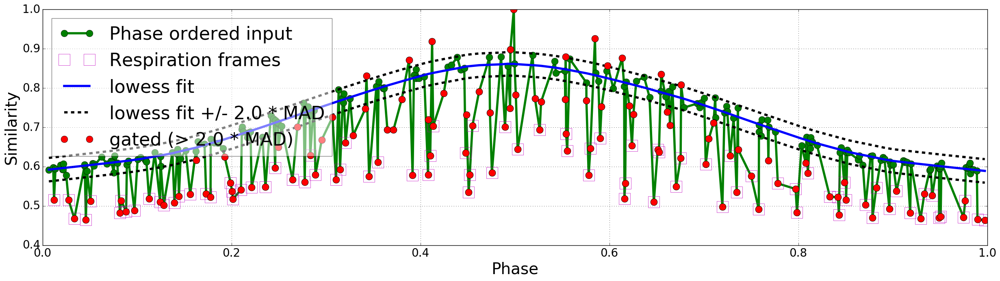

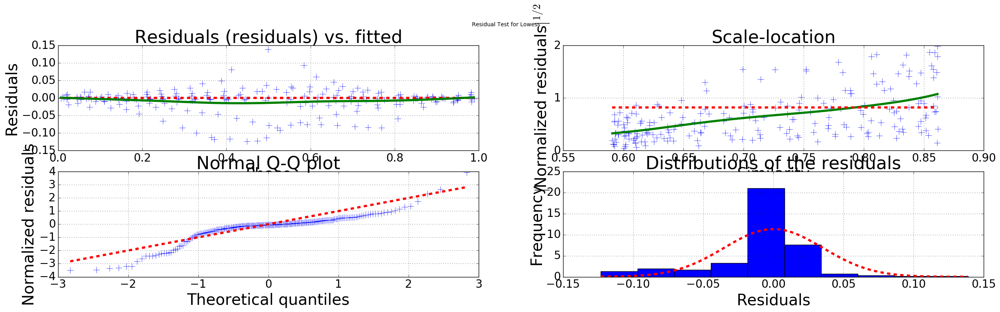

In [30]:
# show initial phase based respiration gating
resp_ind = algo.resp_ind_
print '%.2f%% frames gated due to respiration influence' % (100.0 * len(resp_ind) / len(ts))

plt.figure()
plt.plot(ts_seasonal, 'g-', label='Heart-beat')
plt.plot(ts_trend, 'r-', label='Respiration')
plt.plot(resp_ind, ts_seasonal[resp_ind], 'b.', label='Gated (| ph | < %.2f)' % algo.resp_phase_cutoff)
plt.plot(resp_ind, ts_trend[resp_ind], 'b.')
plt.legend(framealpha=0.5, loc='upper left');

# show lowess bases gating
phaseord_est = np.argsort(ts_instaphase_nmzd)

fid_lowess = algo.fid_lowess_
sim_lowess_reg = algo.sim_lowess_reg_

ph_resp = ts_instaphase_nmzd[resp_ind]
sim_resp = simMat[fid_lowess, resp_ind]

ph_org = ts_instaphase_nmzd[phaseord_est]
sim_org = simMat[fid_lowess, phaseord_est]

sim_lowess = sim_lowess_reg.predict(ph_org)

k_mad = 2.0
gated_ind = phaseord_est[np.argwhere(abs(sim_org - sim_lowess) > k_mad * sim_lowess_reg.residual_mad())]

ph_gated = ts_instaphase_nmzd[gated_ind]
sim_gated = simMat[fid_lowess, gated_ind]


imInput_phaseord = imInput[:,:,phaseord_est]

phaseord_est_gated = [fid for fid in phaseord_est if fid not in gated_ind]
imInput_phaseord_gated = imInput[: , :, phaseord_est_gated]

plt.figure()

plt.plot(ph_org, sim_org, 'g-o', label='Phase ordered input')
plt.plot(ph_resp, sim_resp, 'ms', label='Respiration frames',
         fillstyle='none', markersize=20)
plt.plot(ph_org, sim_lowess, 'b-', label='lowess fit')

plt.plot(ph_org, sim_lowess + k_mad * sim_lowess_reg.residual_mad(), 'k--')
plt.plot(ph_org, sim_lowess - k_mad * sim_lowess_reg.residual_mad(), 'k--', label='lowess fit +/- %.1f * MAD' % k_mad)

plt.plot(ph_gated, sim_gated, 'ro', label='gated (> %.1f * MAD)' % k_mad)

plt.xlabel('Phase')
plt.ylabel('Similarity')
plt.legend(loc='upper left', framealpha=0.5)

# evaluate quality of lowess fit
phaseord_est_wout_resp = [fid for fid in phaseord_est if fid not in resp_ind]

xs = ts_instaphase_nmzd[phaseord_est_wout_resp]
ys = simMat[fid_lowess, phaseord_est_wout_resp]
y_fit = sim_lowess_reg.predict(xs)

plt.figure()

_ = plot_fit.plot_residual_tests(xs, y_fit, ys - y_fit, 'Lowess', 
                                 xname='Phase', yname='Similarity')

In [31]:
# see phase ordered input after gating
utils.cvShowVideo(
    [utils.normalizeArray(imInput_phaseord), utils.normalizeArray(imInput_phaseord_gated)],
    ['Input phase ordered video', 'Input phase ordered video after gating'], resizeAmount=resizeAmount
)

#### Figures depicting noise suppression

In [32]:
#
# Show MIPs of Input, Lowrank and Sparse parts
#
dispframe = 0

if algo_params['apply_lr_denoising']:
    
    # Input
    plt.figure(figsize=(20,15))

    plt.subplot(141)
    mplotShowImage(imInput[:, :, dispframe])
    plt.title('Input')
    SaveImageToDisk(imInput.max(2), resultsDir, 'imInput')

    # smoothed input
    plt.subplot(142)
    mplotShowImage(imD[:, :, dispframe])
    plt.title('Median')
    SaveImageToDisk(imD.max(2), resultsDir, 'imMedian')

    # Low Rank
    plt.subplot(143)
    mplotShowImage(imLowRank[:, :, dispframe])
    plt.title('Low-rank')
    SaveImageToDisk(imLowRank.max(2), resultsDir, 'imLowRank')

    # Sparse
    plt.subplot(144)
    mplotShowImage(imSparse[:, :, dispframe])
    plt.title('Sparse')
    SaveImageToDisk(imSparse.max(2), resultsDir, 'imSparse')

    #
    # Show Mid XT slices of Input, Lowrank and Sparse parts
    #

    # Input
    plt.figure(figsize=(20, 10))

    plt.subplot(221)

    mplotShowImage(imInput[:, mmode_pos, :].T)
    plt.title('Input m-mode')
    plt.xlabel('Time')
    plt.ylabel('Y')
    SaveImageToDisk(imInput[:, mmode_pos, :].T, resultsDir, 'imInput_mmode')

    # Smoothed Input
    plt.subplot(222)

    mplotShowImage(imD[:, mmode_pos, :].T)
    plt.title('Input median m-mode')
    plt.xlabel('Time')
    plt.ylabel('Y')
    SaveImageToDisk(imD[:, mmode_pos, :].T, resultsDir, 'imMedian_mmode')

    # Low Rank
    plt.subplot(223)

    mplotShowImage(imLowRank[:, mmode_pos, :].T)
    plt.title('Lowrank m-mode')
    plt.xlabel('Time')
    plt.ylabel('Y')
    SaveImageToDisk(imLowRank[:, mmode_pos, :].T, resultsDir, 'imLowRank_mmode')

    # Sparse
    plt.subplot(224)

    mplotShowImage(imSparse[:, mmode_pos, :].T)
    plt.title('Sparse m-mode')
    plt.xlabel('Time', fontsize=labelsize)
    plt.ylabel('Y', fontsize=labelsize)
    SaveImageToDisk(imSparse[:, mmode_pos, :].T, resultsDir, 'imSparse_mmode')

#### Figures depicting phase estimation

Heart rate = 512.83 bpm
Heart cycle = 27.27 frames
No of heart cycles recorded = 11.00

Respiration rate = 93.24 bpm
Respiration cycle = 150.00 frames
No of respiration cycles recorded = 2.00


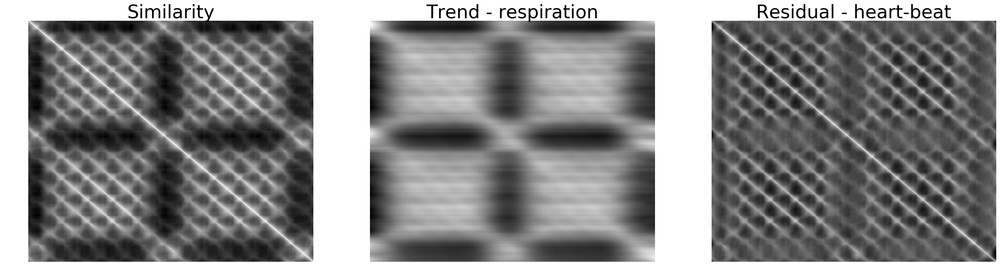

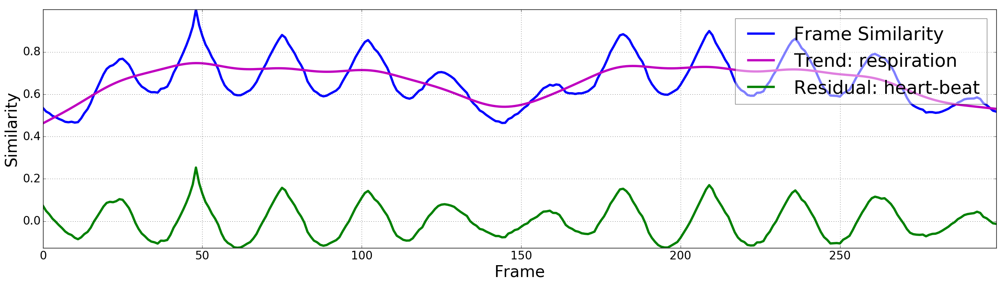

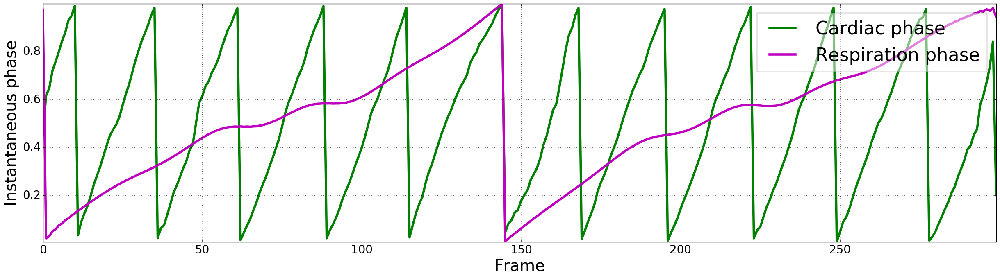

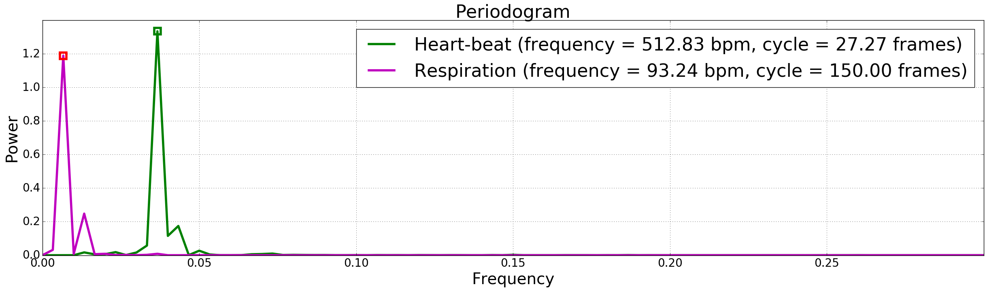

In [33]:
#
# plot the whole similarity landscape along with its trend and seasonal parts
#
fig, ax = plt.subplots(1, 3, sharey=True)

ax[0].imshow(simMat)
ax[0].set_title('Similarity')
ax[0].axis('off')
ax[0].axis('tight')

ax[1].imshow(simMat_Trend)
ax[1].set_title('Trend - respiration')
ax[1].axis('off')
ax[1].axis('tight')

ax[2].imshow(simMat_Seasonal)
ax[2].set_title('Residual - heart-beat')
ax[2].axis('off')
ax[2].axis('tight')

utils.SaveFigToDisk(resultsDir, 'simMat', bbox_inches='tight')

# Demonstrate season-trend decomposition
fig, ax = plt.subplots(1)

ax.plot(ts, 'b-', label=r'Frame Similarity')
ax.plot(ts_trend , 'm-', label='Trend: respiration')
ax.plot(ts_seasonal , 'g-', label='Residual: heart-beat')

ax.set_xlim([0, ts_trend.size])
ax.set_xlabel('Frame')
ax.set_ylabel('Similarity')
ax.legend(framealpha=0.5)
ax.axis('tight')

utils.SaveFigToDisk(resultsDir, 'season_trend_decomposition', bbox_inches='tight')

# show instantaneous phase of heart and respiration
fig, ax = plt.subplots(1)

ax.plot(ts_instaphase_nmzd, 'g-', label='Cardiac phase')
ax.plot(ts_trend_instaphase_nmzd, 'm-', label='Respiration phase')

ax.set_xlabel('Frame')
ax.set_ylabel('Instantaneous phase')
# ax.set_xlim([0, ts_instaphase_nmzd.size])

ax.legend(framealpha=0.5)
ax.axis('tight')

utils.SaveFigToDisk(resultsDir, 'instantaneous_phase', bbox_inches='tight')

# calculate periodicity characteristics
freq_seasonal, power_seasonal = scipy.signal.periodogram(ts_seasonal)
max_power_loc_seasonal = np.argmax(power_seasonal)
period_seasonal = 1.0 / freq_seasonal[max_power_loc_seasonal]
bpm_seasonal = 60.0 * framesPerSecDownsmp / period_seasonal
num_periods_seasonal = ts_seasonal.size / period_seasonal

print 'Heart rate = %.2f bpm' % bpm_seasonal
print 'Heart cycle = %.2f frames' % period_seasonal
print 'No of heart cycles recorded = %.2f' % num_periods_seasonal

freq_trend, power_trend = scipy.signal.periodogram(ts_trend)
max_power_loc_trend = np.argmax(power_trend)
period_trend = 1.0 / freq_trend[max_power_loc_trend]
bpm_trend = 60.0 * framesPerSecDownsmp / period_trend
num_periods_trend = ts_trend.size / period_trend

print '\nRespiration rate = %.2f bpm' % bpm_trend
print 'Respiration cycle = %.2f frames' % period_trend
print 'No of respiration cycles recorded = %.2f' % num_periods_trend

fig, ax = plt.subplots(1)

ax.plot(freq_seasonal, power_seasonal, 'g-', 
        label='Heart-beat (frequency = %.2f bpm, cycle = %.2f frames)' % (
            bpm_seasonal, period_seasonal))

ax.plot(freq_seasonal[max_power_loc_seasonal], power_seasonal[max_power_loc_seasonal], 
         'gs', fillstyle='none', markeredgewidth=linewidth)

ax.plot(freq_trend, power_trend, 'm-', 
         label='Respiration (frequency = %.2f bpm, cycle = %.2f frames)' % (
            bpm_trend, period_trend))

ax.plot(freq_trend[max_power_loc_trend], power_trend[max_power_loc_trend], 
         'rs', fillstyle='none', markeredgewidth=linewidth)

ax.set_xlim(0, 0.3)
ax.set_xlabel('Frequency')
ax.set_ylabel('Power')
ax.legend()
ax.set_title('Periodogram')
ax.set_ybound(0, 1.4)
# ax.axis('tight')

utils.SaveFigToDisk(resultsDir, 'periodogram', bbox_inches='tight')

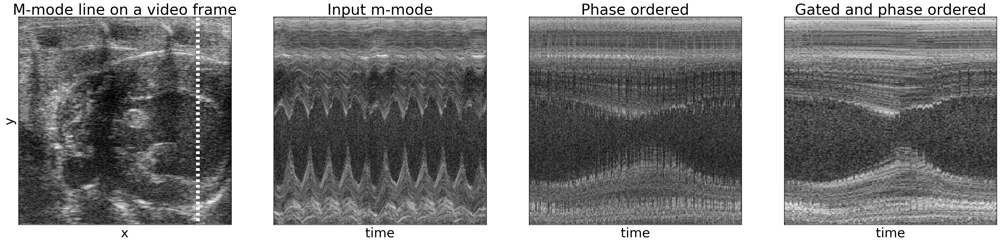

In [34]:
# show image sequence ordered by estimated phase
fig, ax = plt.subplots(1, 4, sharey=True, figsize=(8 * image_aspect * 3.5, 8))

# fig.subplots_adjust(left=0,right=1,bottom=0,top=1)

ax[0].imshow(imInput[:, :, qrs_ploc[1]])
ax[0].plot([mmode_pos, mmode_pos], [0, imInput.shape[0]], 'w--', linewidth=8)
ax[0].set_xlabel('x')
ax[0].set_ylabel('y')
ax[0].set_title('M-mode line on a video frame')
# ax[0].axis('off')
ax[0].axis('tight')

ax[1].imshow(imInput[:, mmode_pos, :])
ax[1].set_xlabel('time')
ax[1].set_title('Input m-mode')
# ax[1].axis('off')
ax[1].axis('tight')

ax[2].imshow(imInput_phaseord[:, mmode_pos, :])
ax[2].set_xlabel('time')
ax[2].set_title('Phase ordered')
# ax[2].axis('off')
ax[2].axis('tight')

ax[3].imshow(imInput_phaseord_gated[:, mmode_pos, :])
ax[3].set_xlabel('time')
ax[3].set_title('Gated and phase ordered')
# ax[3].axis('off')
ax[3].axis('tight')

_ = plt.setp([a.get_xticklabels() for a in ax], visible=False)
_ = plt.setp([a.get_yticklabels() for a in ax], visible=False)

utils.SaveFigToDisk(resultsDir, 'phaseordered', bbox_inches='tight')

#### Figures validating phase estimation

QRS peak         :  [  9  36  63  90 118 143 170 197 225 252 277]
instaphase valley:  [ 11  36  62  89 115 145 169 196 223 249 278]
similarity valley:  [ 11  36  61  88 114 144 171 196 222 247 277]

R^2 instaphase valley vs ECG =  0.999559418937

Difference between instaphase valley and qrs peak locations: 
	[2 0 1 1 3 2 1 1 2 3 1]
	Mean = 1.55, std = 0.89
	Median = 1.00, IQR = 1.00


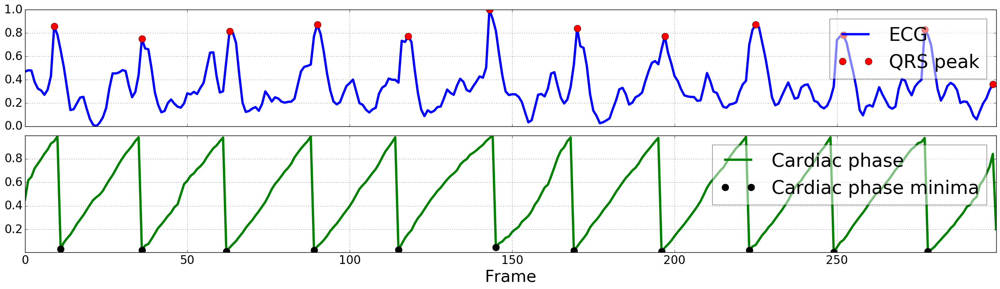

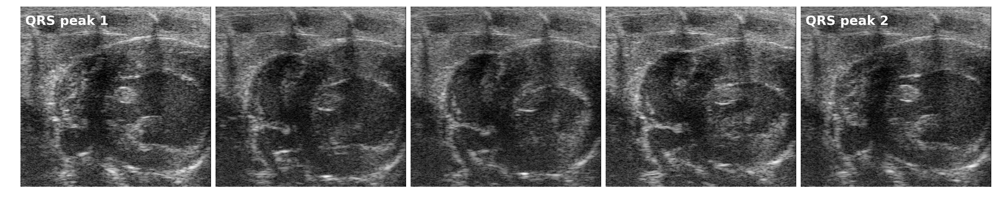

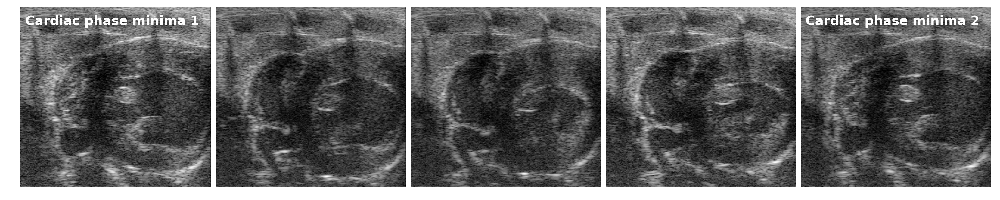

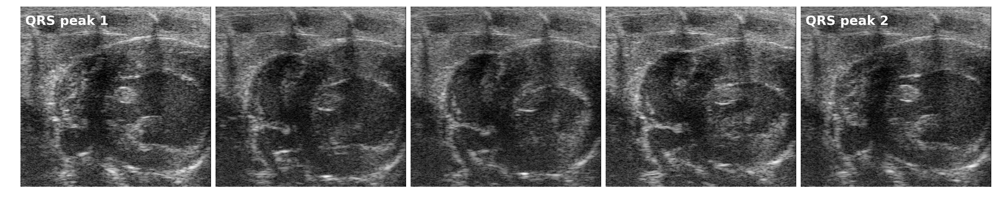

In [35]:
# overlay ECG and instantaneous phase
fig, ax = plt.subplots(2, 1, sharex=True)

fig.subplots_adjust(wspace=0.025, hspace=0.08)

ax[0].plot(ecg_norm, 'b', label='ECG')
ax[0].plot(qrs_ploc, ecg_norm[qrs_ploc], 'ro', label='QRS peak')
ax[0].legend(framealpha = 0.5)
ax[0].axis('tight')

ax[1].plot(ts_instaphase_nmzd, 'g-', label='Cardiac phase')
ax[1].plot(ts_instaphase_nmzd_vloc, ts_instaphase_nmzd[ts_instaphase_nmzd_vloc], 'ko', label='Cardiac phase minima')
ax[1].set_xlabel('Frame')
ax[1].legend(framealpha = 0.5)
ax[1].axis('tight')

_ = plt.setp([a.get_xticklabels() for a in ax[:-1]], visible=False)

utils.SaveFigToDisk(resultsDir, 'ecg_instaphase_overlay', bbox_inches='tight')

### show evenly spaced frames between two consecutive QRS peaks and corresponding instantaneous phase valley
pid = 1
n_frames = 5

# QRS
f_qrs = range(qrs_ploc[pid], qrs_ploc[pid+1]+1, (qrs_ploc[pid+1] - qrs_ploc[pid]) / (n_frames - 1))

fig, ax = plt.subplots(1, len(f_qrs), figsize=(6 * image_aspect * 4, 6))

fig.subplots_adjust(left=0,right=1,bottom=0,top=1, wspace=0.025)

for i in range(len(f_qrs)):
    
    ax[i].imshow(imInput[:, :, f_qrs[i]])
    
    if i == 0:
        ax[i].annotate('QRS peak 1', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    elif i == len(f_qrs) - 1:
        ax[i].annotate('QRS peak 2', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    
    ax[i].axis('tight')
    ax[i].axis('off')
    
utils.SaveFigToDisk(resultsDir, 'qrs_peak_to_peak', bbox_inches='tight')

# Instaphase    
f_insta = range(ts_instaphase_nmzd_vloc[pid], ts_instaphase_nmzd_vloc[pid+1]+1, 
                (ts_instaphase_nmzd_vloc[pid+1] - ts_instaphase_nmzd_vloc[pid]) / (n_frames - 1))

fig, ax = plt.subplots(1, len(f_insta), figsize=(6 * image_aspect * 4, 6))

fig.subplots_adjust(left=0,right=1,bottom=0,top=1, wspace=0.025)

for i in range(len(f_insta)):
    
    ax[i].imshow(imInput[:, :, f_insta[i]])    
    
    if i == 0:
        ax[i].annotate('Cardiac phase minima 1', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    elif i == len(f_qrs) - 1:
        ax[i].annotate('Cardiac phase minima 2', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    
    ax[i].axis('tight')
    ax[i].axis('off')    

utils.SaveFigToDisk(resultsDir, 'instaphase_valley_to_valley', bbox_inches='tight')        
        
# checkerboard    
fig, ax = plt.subplots(1, len(f_qrs), figsize=(6 * image_aspect * 4, 6))

fig.subplots_adjust(left=0,right=1,bottom=0,top=1, wspace=0.025)

for i in range(len(f_qrs)):    
    
    im_chk = utils.vis_checkerboard(imInput[:, :, f_qrs[i]], imInput[:, :, f_insta[i]])
    
    ax[i].imshow(im_chk)
    
    if i == 0:
        ax[i].annotate('QRS peak 1', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    elif i == len(f_qrs) - 1:
        ax[i].annotate('QRS peak 2', xy=(0.05, 0.9), xytext=(0.025, 0.9), 
                       xycoords='axes fraction', fontsize=labelsize*1.1, fontweight='bold', color='w')
    
    ax[i].axis('tight')
    ax[i].axis('off')    

        
utils.SaveFigToDisk(resultsDir, 'instaphase_qrs_checkerboard', bbox_inches='tight')

# validation
num_points = min([qrs_ploc.size, ts_instaphase_nmzd_vloc.size])

print 'QRS peak         : ', qrs_ploc[:num_points]
print 'instaphase valley: ', ts_instaphase_nmzd_vloc[:num_points]
print 'similarity valley: ', ts_seasonal_vloc[:num_points]

print '\nR^2 instaphase valley vs ECG = ', sklearn.metrics.r2_score(qrs_ploc[:num_points], 
                                                                    ts_instaphase_nmzd_vloc[:num_points])

insta_qrs_diff = np.abs(ts_instaphase_nmzd_vloc[:num_points] - qrs_ploc[:num_points])

print '\nDifference between instaphase valley and qrs peak locations: \n\t', insta_qrs_diff
print '\tMean = %.2f, std = %.2f' % (np.mean(insta_qrs_diff), np.std(insta_qrs_diff))
print '\tMedian = %.2f, IQR = %.2f' % (np.median(insta_qrs_diff), scipy.stats.iqr(insta_qrs_diff))

#### Figures depicting respiratory gating

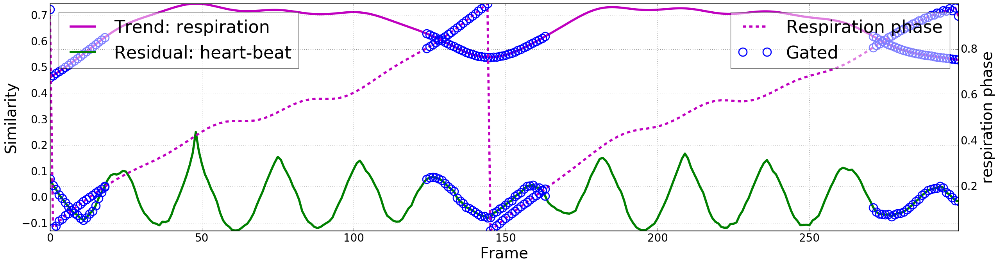

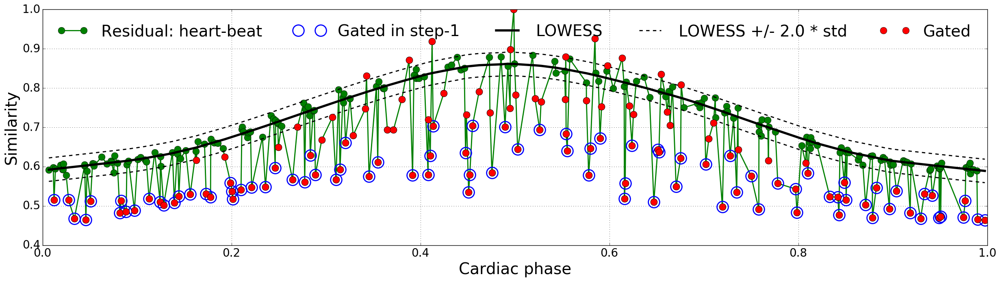

In [36]:
# show initial phase based respiration gating
ts_seasonal_norm = utils.normalizeArray(ts_seasonal)
ts_trend_norm = utils.normalizeArray(ts_trend)

fig, ax1 = plt.subplots(1)

ax1.plot(ts_trend, 'm-', label='Trend: respiration')
ax1.plot(resp_ind, ts_trend[resp_ind], 'bo', 
         fillstyle='none', markersize=15, markeredgewidth=linewidth/2)

ax1.plot(ts_seasonal, 'g-', label='Residual: heart-beat')

ax1.plot(resp_ind, ts_seasonal[resp_ind], 'bo', 
         fillstyle='none', markersize=15, markeredgewidth=linewidth/2)

ax1.set_xlabel('Frame')
ax1.set_ylabel('Similarity')
ax1.legend(framealpha=0.5, loc='upper left');
ax1.axis('tight')

ax2 = ax1.twinx()
ax2.plot(ts_trend_instaphase_nmzd, 'm--', label='Respiration phase')
ax2.plot(resp_ind, ts_trend_instaphase_nmzd[resp_ind], 'bo', 
         fillstyle='none', markersize=15, markeredgewidth=linewidth/2,
         label='Gated')

ax2.set_ylabel('respiration phase')
ax2.legend(framealpha=0.5, loc='upper right');
ax2.axis('tight')

utils.SaveFigToDisk(resultsDir, 'respiratory_phase_gating', bbox_inches='tight')

# show lowess bases gating
phaseord_est = np.argsort(ts_instaphase_nmzd)

fid_lowess = algo.fid_lowess_
sim_lowess_reg = algo.sim_lowess_reg_

ph_resp = ts_instaphase_nmzd[resp_ind]
sim_resp = simMat[fid_lowess, resp_ind]

ph_org = ts_instaphase_nmzd[phaseord_est]
sim_org = simMat[fid_lowess, phaseord_est]

sim_lowess = sim_lowess_reg.predict(ph_org)

k_mad = 2.0
gated_ind = phaseord_est[np.argwhere(abs(sim_org - sim_lowess) > k_mad * sim_lowess_reg.residual_mad())]

ph_gated = ts_instaphase_nmzd[gated_ind]
sim_gated = simMat[fid_lowess, gated_ind]

phaseord_est_gated = [fid for fid in phaseord_est if fid not in gated_ind]
imInput_phaseord_est = imInput[:,:,phaseord_est_gated]
imInputDenoised_phaseord_est = imInputDenoised[: , :, phaseord_est_gated]

fig, ax = plt.subplots(1)

ax.plot(ph_org, sim_org, 'g-o', label='Residual: heart-beat', linewidth=linewidth/2)
ax.plot(ph_resp, sim_resp, 'bo', label='Gated in step-1',
        fillstyle='none', markersize=20, markeredgewidth=linewidth/2)
ax.plot(ph_org, sim_lowess, 'k-', label='LOWESS', linewidth=linewidth)

ax.plot(ph_org, sim_lowess + k_mad * sim_lowess_reg.residual_mad(), 'k--', 
         label='LOWESS +/- %.1f * std' % k_mad, linewidth=linewidth/2)
ax.plot(ph_org, sim_lowess - k_mad * sim_lowess_reg.residual_mad(), 'k--', linewidth=linewidth/2)

ax.plot(ph_gated, sim_gated, 'ro', label='Gated')

ax.set_xlabel('Cardiac phase')
ax.set_ylabel('Similarity')

plt.legend(bbox_to_anchor=(0.0, 1.0), loc='upper left', ncol=5, framealpha=0, fontsize=labelsize)

# _ = ax.legend(loc='upper left', framealpha=0.5)

utils.SaveFigToDisk(resultsDir, 'robust_lowess_gating', bbox_inches='tight')

#### Video depicting noise suppression

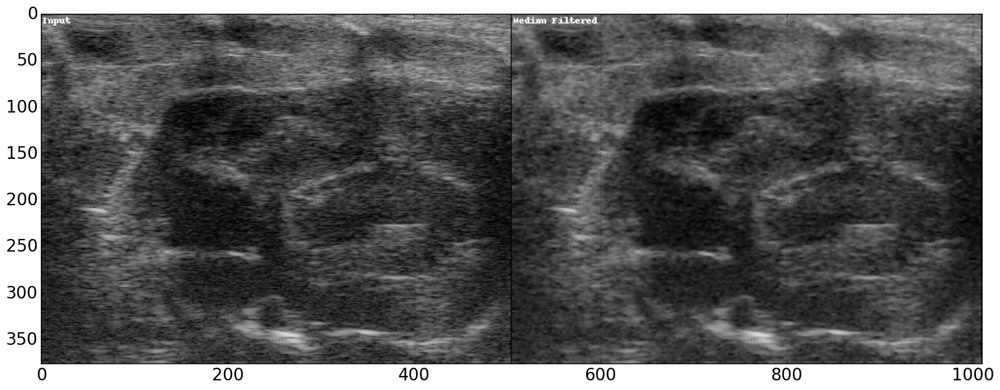

In [37]:
if algo_params['apply_lr_denoising']:

    imNoiseSuppressionVideo = np.zeros_like( np.tile(imInput, (2, 2, 1)) )

    rsize, csize, nframes  = imInput.shape
    imNoiseSuppressionVideo[:rsize, :csize, :] = utils.AddTextOnVideo( imInput, 'Input' )
    imNoiseSuppressionVideo[:rsize, csize:, :] = utils.AddTextOnVideo( imD, 'Median Filtered' )
    imNoiseSuppressionVideo[rsize:, :csize, :] = utils.AddTextOnVideo( imLowRank, 'Low-rank' )
    imNoiseSuppressionVideo[rsize:, csize:, :] = utils.AddTextOnVideo( normalizeArray(imSparse) * 255, 'Sparse' )

else:
    
    imNoiseSuppressionVideo = np.zeros_like( np.tile(imInput, (1, 2, 1)) )

    rsize, csize, nframes  = imInput.shape
    imNoiseSuppressionVideo[:rsize, :csize, :] = utils.AddTextOnVideo( imInput, 'Input' )
    imNoiseSuppressionVideo[:rsize, csize:, :] = utils.AddTextOnVideo( imInputDenoised, 'Median Filtered' )
    
# show mip
plt.figure()
plt.imshow(imNoiseSuppressionVideo[:, :, 0])

In [38]:
# write our result
utils.writeVideoToFile(
    utils.normalizeArray(imNoiseSuppressionVideo) * 255, 
    os.path.join(resultsDir, 'NoiseSuppressionResult.avi'), 
    codec='DIVX', fps=outFPS
)

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/NoiseSuppressionResult.avi took 1.97992897034 seconds


#### Video depicting phase estimation

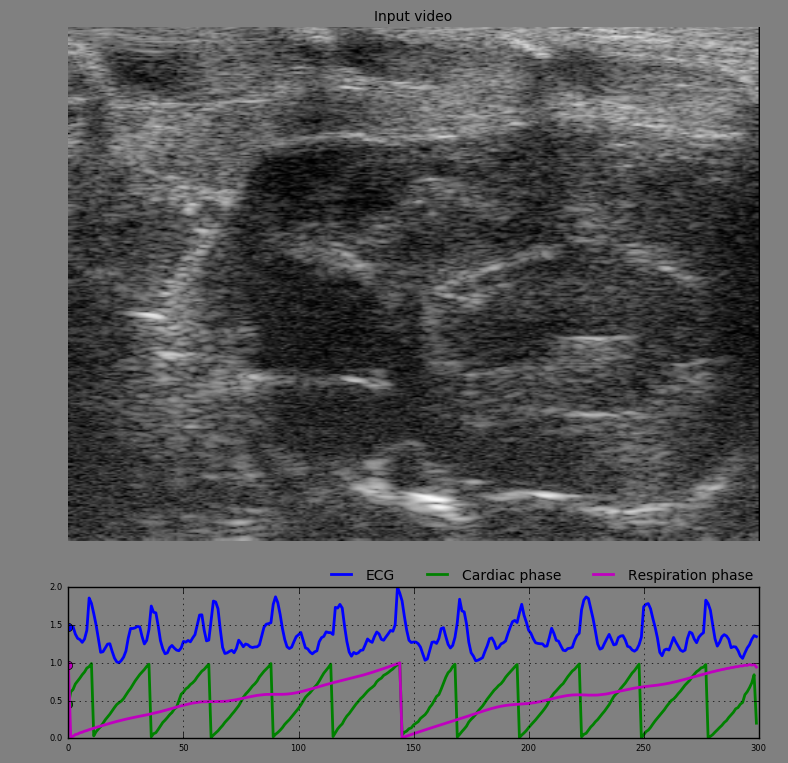

In [39]:
imPhaseEstimationVideo = []

for i in range(imInput.shape[2]):
    
    print i, 

    fig = plt.figure(figsize=(8, 8))
    fig.patch.set_facecolor('gray')

    gs = gridspec.GridSpec(2, 1, height_ratios=[4, 1])
    gs.update(wspace=0, hspace=0) # set the spacing between axes.

    ax1 = plt.subplot(gs[0])
    ax1.imshow(imInput[:, :, i])
    ax1.set_title('Input video', fontsize=10)
    ax1.axis('off')

    ax2 = plt.subplot(gs[1], axisbg='gray')

    ax2.plot(1 + ecg_norm, 'b-', linewidth= 2, label='ECG')
    ax2.plot(i, 1 + ecg_norm[i], 'bo', markersize=markersize/2)

    ax2.plot(ts_instaphase_nmzd, 'g-', linewidth= 2, label='Cardiac phase')
    ax2.plot(i, ts_instaphase_nmzd[i], 'go', markersize=markersize/2)

    ax2.plot(ts_trend_instaphase_nmzd, 'm-', linewidth= 2, label='Respiration phase')
    ax2.plot(i, ts_trend_instaphase_nmzd[i], 'mo', markersize=markersize/2)

    ax2.tick_params(labelsize=6)
    plt.legend(bbox_to_anchor=(1.01, 0.95), loc='lower right', ncol=3, framealpha=0, fontsize=10)

    plt.tight_layout()

    imFig = utils.fig2data(fig)
    imPhaseEstimationVideo.append(imFig)
    
    display(plt.gcf())
    clear_output(wait=True)
    time.sleep(1.0 / 60.0)

    # del fig
    if i > 0:
        _ = fig.clear()
    
imPhaseEstimationVideo = np.stack(imPhaseEstimationVideo, axis=3)

In [40]:
# write our result
utils.writeVideoToFile(
    imPhaseEstimationVideo, 
    os.path.join(resultsDir, 'PhaseEstimationResult.avi'), 
    codec='MJPG', fps=outFPS, isColor=True
)

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/PhaseEstimationResult.avi took 3.65564703941 seconds


#### Video depicting super-resolution

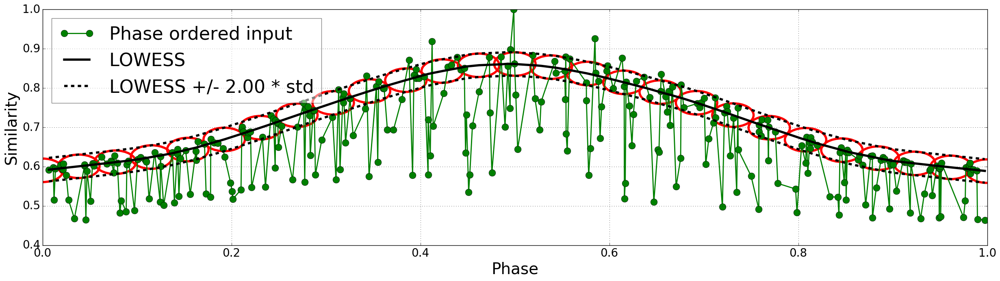

In [42]:
# tweak and visualize sigma factors for kernel regression
kPhase = 0.4
kSim = 2
mag = 1

synthPhaseVals = np.linspace(0, 1, np.round(period))

phaseord_est = np.argsort(algo.ts_instaphase_nmzd_)

ph_org = algo.ts_instaphase_nmzd_[phaseord_est]
sim_org = algo.ts_[phaseord_est]

sim_lowess = algo.sim_lowess_reg_.predict(ph_org)
sim_mad = algo.sim_lowess_reg_.residual_mad()

pdiff = uspgs.phaseDiff(algo.ts_instaphase_nmzd_)
pstd = sm.robust.scale.mad(pdiff, center=0)
# pstd = np.mean(superUS.phaseDiff(np.sort(algo.ts_instaphase_nmzd_)))

synthPhaseSims = algo.sim_lowess_reg_.predict(synthPhaseVals)

wPhase = 2 * kPhase * pstd
wSim = 2 * kSim * sim_mad

plt.plot(ph_org, sim_org, 'g-o', linewidth=linewidth/2, label='Phase ordered input')
plt.plot(ph_org, sim_lowess, 'k-', label='LOWESS')

plt.plot(ph_org, sim_lowess + kSim * sim_mad, 'k--')
plt.plot(ph_org, sim_lowess - kSim * sim_mad, 'k--', label='LOWESS +/- %.2f * std' % kSim)

for cur_ph, cur_sim in zip(synthPhaseVals, synthPhaseSims):
    
    c = [cur_ph, cur_sim]
    
    cur_el = mpatches.Ellipse(xy=c, width=wPhase, height=wSim, fill=False, color='r', linewidth=linewidth)
    plt.gca().add_patch(cur_el)

plt.xlabel('Phase')
plt.ylabel('Similarity')
plt.legend(loc='upper left', framealpha=0.5)

upsampling by 1 using kernel_regression_phase_sim
03% 07% 11% 14% 18% 22% 25% 29% 33% 37% 40% 44% 48% 51% 55% 59% 62% 66% 70% 74% 77% 81% 85% 88% 92% 96% 

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/OnePeriodVideo_Mag_1_kernel_regression_phase_sim.avi took 0.0732531547546 seconds


upsampling by 2 using kernel_regression_phase_sim
01% 03% 05% 07% 09% 10% 12% 14% 16% 18% 20% 21% 23% 25% 27% 29% 30% 32% 34% 36% 38% 40% 41% 43% 45% 47% 49% 50% 52% 54% 56% 58% 60% 61% 63% 65% 67% 69% 70% 72% 74% 76% 78% 80% 81% 83% 85% 87% 89% 90% 92% 94% 96% 98% 

True
Writing video paper_figures/decoded/2015-07-27-10-36-06_2015-07-15-16-56-16_1.raw.bmode/OnePeriodVideo_Mag_2_kernel_regression_phase_sim.avi took 0.136837005615 seconds


upsampling by 4 using kernel_regression_phase_sim
01% 02% 03% 04% 05% 06% 07% 08% 09% 10% 11% 12% 13% 14% 15% 16% 17% 18% 19% 20% 21% 22% 23% 24% 25% 26% 27% 28% 29% 30% 31% 32% 33% 34% 35% 36% 37% 38% 39% 40% 41% 42% 43% 4

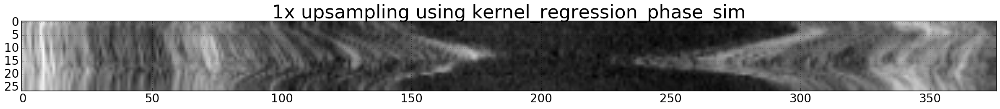

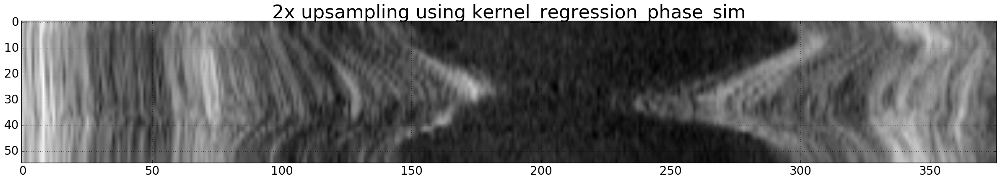

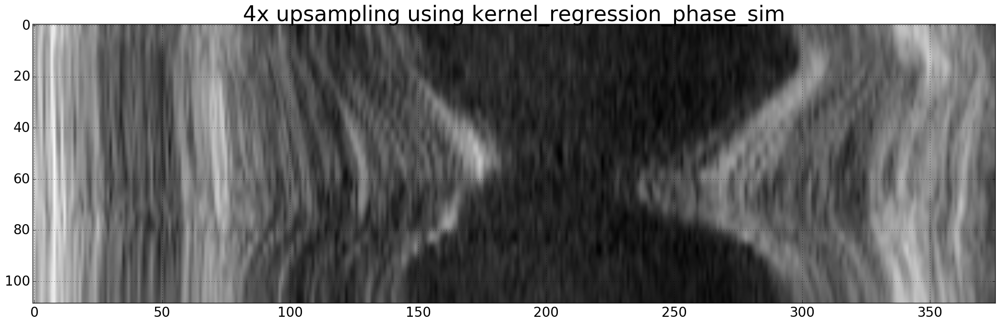

In [44]:
# set parmeters
upsampleAmountList = [1, 2, 4]
sigmaSimilarityFactor = kSim
sigmaPhaseFactor = kPhase

linear_interp_params = uspgs.config_framegen_using_linear_interpolation()

kreg_params = uspgs.config_framegen_using_kernel_regression(sigmaPhaseFactor=sigmaPhaseFactor)

kreg_params_sim = uspgs.config_framegen_using_kernel_regression(
    sigmaPhaseFactor=sigmaPhaseFactor, 
    sigmaSimilarityFactor=sigmaSimilarityFactor, 
    stochastic=False)

kreg_params_sim_stochastic = uspgs.config_framegen_using_kernel_regression(
    sigmaPhaseFactor=sigmaPhaseFactor,
    sigmaSimilarityFactor=sigmaSimilarityFactor,
    stochastic=True)

bspline_reg_params = uspgs.config_framegen_using_bspline_registration()

# mparams_list = [kreg_params_sim, kreg_params, linear_interp_params]
mparams_list = [kreg_params_sim]

# generate one-period video at higher resolution
outVideoList = []

for mparams in mparams_list:    
    
    for upsampleAmount in upsampleAmountList:    
        
        print 'upsampling by %d using %s' % (upsampleAmount, mparams['name'])

        numOutFrames = np.uint(upsampleAmount * period + 0.5)        
        
        imCurOnePeriodVideo_Input = algo.generate_single_cycle_video(numOutFrames, 
                                                                     imInput=imInput, 
                                                                     method=mparams)
        
        if algo_params['apply_lr_denoising']:
            
            imCurOnePeriodVideo_Lowrank = algo.generate_single_cycle_video(numOutFrames, 
                                                                           imInput=imLowRank, 
                                                                           method=mparams)

        rsize, csize, nframes  = imCurOnePeriodVideo_Input.shape
        
        # generate images
        utils.SaveImageToDisk(imCurOnePeriodVideo_Input[:, mmode_pos, :],
                              resultsDir, 'Input_Mag_%d_%s' % (upsampleAmount, mparams['name']))

        if algo_params['apply_lr_denoising']:
        
            utils.SaveImageToDisk(imCurOnePeriodVideo_Lowrank[:, mmode_pos, :].T,
                                  resultsDir, 'LowRank_Mag_%d_%s' % (upsampleAmount, mparams['name']))
        
        # generate demo video
        if algo_params['apply_lr_denoising']:

            imCurOnePeriodVideo = np.zeros_like(np.tile(imCurOnePeriodVideo_Input, (1, 2, 1)))

            imCurOnePeriodVideo[:rsize, :csize, :] = utils.AddTextOnVideo(imCurOnePeriodVideo_Input,
                                                                          'Input Mag %d' % upsampleAmount)
            imCurOnePeriodVideo[:rsize, csize:, :] = utils.AddTextOnVideo(imCurOnePeriodVideo_Lowrank,
                                                                          'Low-rank Mag %d' % upsampleAmount)
        else:
            
            
            imCurOnePeriodVideo = utils.AddTextOnVideo(imCurOnePeriodVideo_Input,
                                                       'Input Mag %d' % upsampleAmount)
            
        utils.writeVideoToFile(
            utils.normalizeArray(imCurOnePeriodVideo) * 255, 
            os.path.join(resultsDir, 
                         'OnePeriodVideo_Mag_%d_%s.avi' % (upsampleAmount, mparams['name']) ), 
            codec='DIVX', fps=outFPS
        )

        plt.figure()        
        plt.imshow(imCurOnePeriodVideo_Input[:, mmode_pos, :].T)
        plt.title('%dx upsampling using %s' % (upsampleAmount, mparams['name']))
        
        print '\n'

In [45]:
num_rounds = 50
print 'LOOCV - %d rounds' % num_rounds

mvals = algo.validate_frame_generation(k = 1, rounds=num_rounds, method=kreg_params_sim, 
                                       metric='ncorr', k_mad=2.0, exclude_similar_phase_frames=True)
print '\tmean = %f, std = %f' % (np.mean(mvals), np.std(mvals))
print '\tmedian = %f, IQR = %f' % (np.median(mvals), scipy.stats.iqr(mvals))

LOOCV - 50 rounds
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 
[ 0.89201838  0.83258507  0.85660429  0.89159754  0.8326264   0.85863536
  0.84228085  0.89893246  0.77230499  0.80714392  0.86542223  0.86302126
  0.85972641  0.89572523  0.80683134  0.86586722  0.890294    0.84162918
  0.88487892  0.87134577  0.87800984  0.87480066  0.86758547  0.86034207
  0.86626637  0.87587112  0.88471148  0.89176749  0.80556811  0.86716091
  0.86743216  0.87701527  0.79082641  0.82882162  0.87134577  0.90408559
  0.79082641  0.86542223  0.87512148  0.7463505   0.87814861  0.86224256
  0.87058369  0.86242867  0.83258507  0.80177524  0.88335183  0.85063217
  0.89973089  0.77230499]
	mean = 0.854652, std = 0.036539
	median = 0.865645, IQR = 0.042884


In [46]:
# compute similarity statistics between QRS peak frames
sim_qrs = []

for i in range(len(qrs_ploc)):
    
    if qrs_ploc[i] in algo.resp_ind_:
        continue
        
    for j in range(i+1, len(qrs_ploc)):
        
        if qrs_ploc[j] in algo.resp_ind_:
            continue
            
        sim_qrs.append( simMat[qrs_ploc[i], qrs_ploc[j]] )

print 'Similarity between QRS peak frames in the input video ...'        
print '\tmean = %f, std = %f' % (np.mean(sim_qrs), np.std(sim_qrs))
print '\tmedian = %f, IQR = %f' % (np.median(sim_qrs), scipy.stats.iqr(sim_qrs))

Similarity between QRS peak frames in the input video ...
	mean = 0.798136, std = 0.053257
	median = 0.791538, IQR = 0.071304
